In [1]:
import os
import csv
import json
from tqdm import tqdm
import shutil
import matplotlib.pyplot as plt
from PIL import Image

meta_path = "/data/noah/inference/data_filtering/data_filtering.csv"
data = []

# CSV 파일을 읽기 모드로 엽니다.
with open(meta_path, "r", newline="") as csvfile:
    # CSV 파일을 읽기 위한 reader 객체를 생성합니다.
    csv_reader = csv.reader(csvfile)

    # 각 행을 반복하면서 데이터를 처리합니다.
    for idx, row in enumerate(csv_reader):
        data.append({"file_name": row[0], "score": row[1]})

base_path = "/data/noah/inference/data_filtering/images"
sorted_data = sorted(data, key=lambda x: x["score"])

In [2]:
average_score = 0.0

for s in sorted_data:
    score = s["score"]
    average_score += float(score)

average_score = float(average_score / len(sorted_data))
average_score

6.040249998856215

In [3]:
good_data = []
bad_data = []

for s in sorted_data:
    if s["file_name"].startswith("syn"):
        if float(s["score"]) <= average_score:
            good_data.append(s)
        else:
            bad_data.append(s)

good_data
bad_data

[{'file_name': 'synthetic_5.png', 'score': '6.046379188176686'},
 {'file_name': 'synthetic_87.png', 'score': '6.050992631004264'},
 {'file_name': 'synthetic_27.png', 'score': '6.061445009701718'},
 {'file_name': 'synthetic_192.png', 'score': '6.078936620641874'},
 {'file_name': 'synthetic_1.png', 'score': '6.095284326875991'},
 {'file_name': 'synthetic_65.png', 'score': '6.1045838352236546'},
 {'file_name': 'synthetic_26.png', 'score': '6.1139831995433065'},
 {'file_name': 'synthetic_118.png', 'score': '6.123251723056803'},
 {'file_name': 'synthetic_11.png', 'score': '6.14256830566969'},
 {'file_name': 'synthetic_148.png', 'score': '6.143000920039265'},
 {'file_name': 'synthetic_19.png', 'score': '6.154507803304174'},
 {'file_name': 'synthetic_144.png', 'score': '6.158439929530574'},
 {'file_name': 'synthetic_93.png', 'score': '6.1734112600043245'},
 {'file_name': 'synthetic_135.png', 'score': '6.192303215017748'},
 {'file_name': 'synthetic_8.png', 'score': '6.225186170783795'},
 {'fil

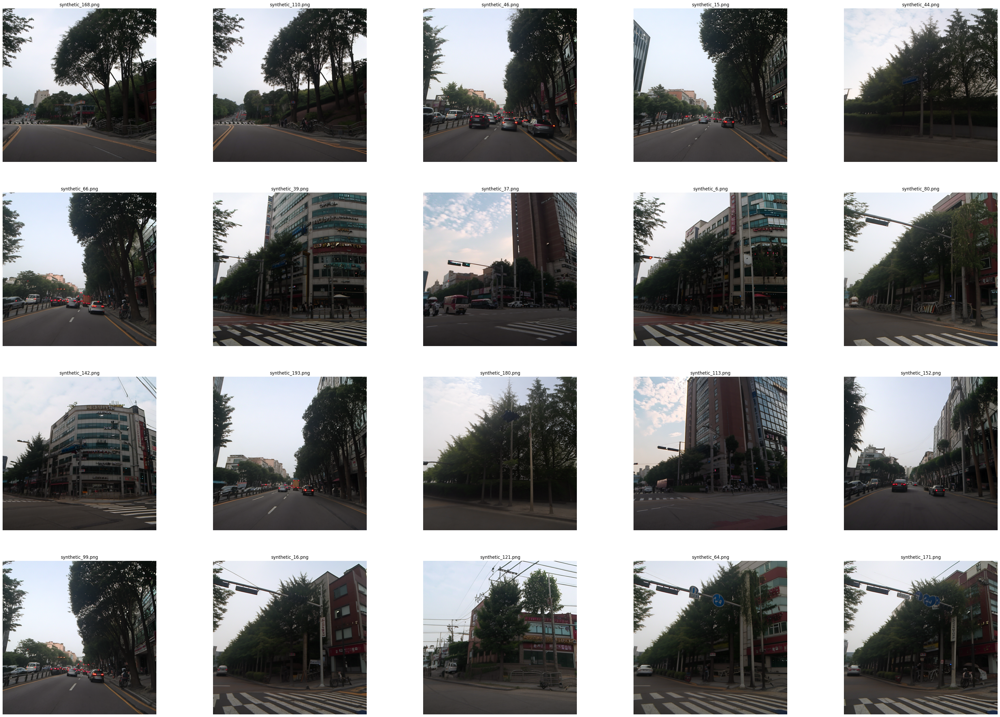

In [5]:
import os

save_path = "/data/noah/inference/data_filtering/good"
good_images = []
os.makedirs(save_path, exist_ok=True)

for t in good_data:
    img_path = os.path.join(base_path, t["file_name"])
    img = Image.open(img_path).convert("RGB")
    img.save(os.path.join(save_path, t["file_name"]))
    good_images.append(img)

plt.figure(figsize=(50, 35))

for i in range(20):
    plt.subplot(4, 5, i + 1)
    plt.imshow(good_images[i])
    plt.title(good_data[i]["file_name"])
    plt.axis("off")

plt.show()

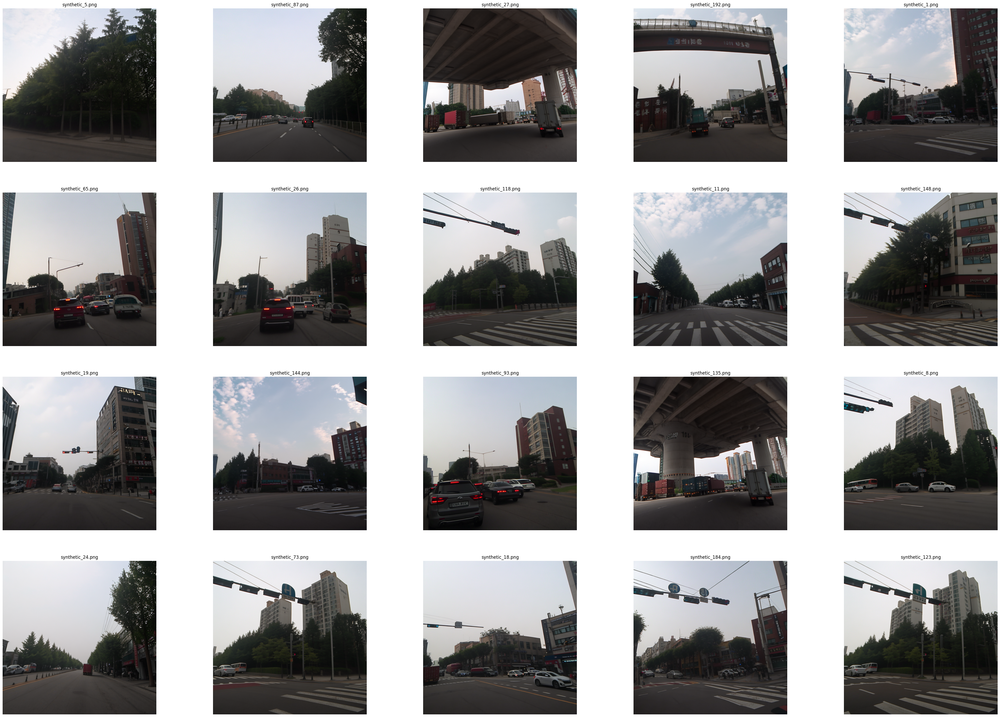

In [6]:
save_path = "/data/noah/inference/data_filtering/bad"
bad_images = []
os.makedirs(save_path, exist_ok=True)

for t in bad_data:
    img_path = os.path.join(base_path, t["file_name"])
    img = Image.open(img_path).convert("RGB")
    img.save(os.path.join(save_path, t["file_name"]))
    bad_images.append(img)

plt.figure(figsize=(50, 35))

for i in range(20):
    plt.subplot(4, 5, i + 1)
    plt.imshow(bad_images[i])
    plt.title(bad_data[i]["file_name"])
    plt.axis("off")

plt.show()

In [8]:
len(good_data)
# len(bad_data)

69